# Standardized analysis

## Env

### Library

In [1]:
import scvelo as scv
import pandas

In [2]:
palette = [
    '#F0A3FF', #Amethyst
    '#0075DC', #Blue
    '#993F00', #Caramel
    '#4C005C', #Damson
    '#191919', #Ebony
    '#005C31', #Forest
    '#2BCE48', #Green
    '#FFCC99', #Honeydew
    '#808080', #Iron
    '#94FFB5', #Jade
    '#8F7C00', #Khaki
    '#9DCC00', #Lime
    '#C20088', #Mallow
    '#003380', #Navy
    '#FFA405', #Orpiment
    '#FFA8BB', #Pink
    '#426600' #Quagmire
]
len(palette)

17

### Function

In [3]:
def load_loom_file(filename):
    adata = scv.read(filename, cache=True)
    adata.var_names_make_unique()
    return(adata)

def read_cluster_from_seurat(filename, origIdent):
    df = pandas.read_csv(filename)
    # tolgo alcuni caratteri che vengono aggiunti in automatico
    for i in df.index:
        df['V1'][i] = df['V1'][i].rstrip('-1_2')
    # sistemo i nomi delle cellule perchè io li rinomino
    for i in range(len(df.index)):
        df['V1'][i] =  df['V1'][i].replace(origIdent,'')
    return(df)

def merge_info_cluster_and_velocyto(adata, origIdent,origIdent2, df):
    
    adata.obs['seurat'] = 'filtered'
    adata.obs['cell_name'] = 'tobeassigned'
    for i in range(len(adata.obs.index)):
        adata.obs['cell_name'][i] = adata.obs.index[i].replace(origIdent+':','').replace('x','')
    for j in range(len(adata.obs['cell_name'])):
        for i in range(len(df['V1'])):
            if df['V1'][i] == adata.obs['cell_name'][j]:
                adata.obs['seurat'][j] = df[origIdent2][i]
                break
    adata = adata[adata.obs['seurat'] != 'filtered',:]
    return(adata)

def computeVelocity(adata_filt):
    scv.pl.proportions(adata_filt)
    scv.pp.filter_and_normalize(adata_filt, n_top_genes=4000)
    scv.pp.moments(adata_filt, n_pcs=30, n_neighbors=30)
    scv.tl.velocity(adata_filt)
    scv.tl.velocity_graph(adata_filt)
    scv.tl.umap(adata_filt)
    scv.tl.velocity_confidence(adata_filt)
    scv.tl.score_genes_cell_cycle(adata_filt)
    scv.tl.velocity_pseudotime(adata_filt)
    return(adata_filt)


def visualizeResults(adata_filt, palette, filename = False):
    scv.pl.umap(adata_filt, color=['seurat'], palette = palette, legend_loc='right_margin', save=filename)
    scv.pl.velocity_embedding_stream(adata_filt, basis='umap', color=['seurat'], palette = palette, 
                                 save=filename, dpi=100, legend_loc='right_margin',
                            linewidth = 0.5, figsize = [10, 10], size = 300)
    scv.pl.velocity_embedding_grid(adata_filt, basis='umap', color=['seurat'], palette = palette, legend_loc='right_margin', 
                                   save=filename, arrow_length = 4, linewidth = 0.5, figsize = [10, 10], size = 100,alpha = 0.5)
    #scv.tl.velocity_confidence(adata_filt)
    scv.pl.scatter(adata_filt, c='velocity_length', cmap='coolwarm', perc=[5, 95], save=filename)
    scv.pl.scatter(adata_filt, c='velocity_confidence', cmap='coolwarm', perc=[5, 95], save=filename)
    #scv.tl.score_genes_cell_cycle(intact_adata_filt)
    scv.pl.scatter(adata_filt, color_gradients=['S_score', 'G2M_score'], smooth=True, perc=[5, 95])
    scv.pl.scatter(adata_filt, color='velocity_pseudotime', cmap='gnuplot')

    
    
    
#"/beegfs/scratch/ric.cosr/ric.bonanomi/BonanomiD_1749_scRNA_nerve/R_DATA/uninj_cell_umap.csv"
#_scINTACT_subset_
def Umap_form_seurat_and_computing_velocity(adata_filt_seurat, coordinats_file, origIdent):
    ucoord = scv.load(coordinats_file)
    ucoord.index = [ x.rstrip('-1_2') for x in ucoord.index ]
    ucoord.index = [ x.replace(origIdent,'') for x in ucoord.index ]
    ucoord = ucoord.reindex(index=adata_filt_seurat.obs['cell_name'].values)
    ucoord = ucoord.to_numpy()
    adata_filt_seurat.obsm['X_umap'] = ucoord
    scv.tl.velocity(adata_filt_seurat)
    scv.tl.velocity_graph(adata_filt_seurat)
    scv.tl.velocity_confidence(adata_filt_seurat)
    scv.tl.score_genes_cell_cycle(adata_filt_seurat)
    return(adata_filt_seurat)

def Identify_important_genes(adata_filt_seurat):
    scv.tl.rank_velocity_genes(adata_filt_seurat, groupby='CellType', min_corr=.3)
    df = scv.DataFrame(adata_filt_seurat.uns['rank_velocity_genes']['names'])
    for i in range(df.shape[1]):
        print("Results cluster "+ str(i+1))
        i = str(i+1)
        kwargs = dict(frameon=False, size=10, linewidth=1.5,add_outline=str(i))
        scv.pl.scatter(adata_filt_seurat, df[str(i)][:10], ylabel='1',color='seurat', **kwargs, ncols=2, legend_loc = "right margin")
    return(df)

def Paga_function(adata_filt):
    adata_filt.uns['neighbors']['distances'] = adata_filt.obsp['distances']
    adata_filt.uns['neighbors']['connectivities'] = adata_filt.obsp['connectivities']
    scv.tl.paga(adata_filt, groups='seurat')
    scv.pl.paga(adata_filt, basis='umap', size=50, alpha=.1,min_edge_width=2, node_size_scale=1.5)



## Computing scVelo UMPA and Velocity

In [5]:
filename_intact = "/beegfs/scratch/ric.cosr/ric.bonanomi/counts_Tomato_ref_BonanomiD_1749_scRNA_nerve/Intact_TdTomato/velocyto/Intact_TdTomato.loom"
filename_D7 = "/beegfs/scratch/ric.cosr/ric.bonanomi/counts_Tomato_ref_BonanomiD_1749_scRNA_nerve/D7_TdTomato/velocyto/D7_TdTomato.loom"
filename_D21 = "/beegfs/scratch/ric.cosr/ric.bonanomi/counts_Tomato_ref_BonanomiD_1749_scRNA_nerve/D21_TdTomato/velocyto/D21_TdTomato.loom"

intact_adata = load_loom_file(filename_intact)
D7_adata = load_loom_file(filename_D7)
D21_adata = load_loom_file(filename_D21)

seurat_filename_intact = "/beegfs/scratch/ric.cosr/ric.bonanomi/BonanomiD_1749_scRNA_nerve/R_DATA/Clusring_ad_Hoc_df_intact_cluster_cell_scVelo.csv"
seurat_filename_D7 = "/beegfs/scratch/ric.cosr/ric.bonanomi/BonanomiD_1749_scRNA_nerve/R_DATA/Clusring_ad_Hoc_df_D7_cluster_cell_scVelo.csv"
seurat_filename_D21 = "/beegfs/scratch/ric.cosr/ric.bonanomi/BonanomiD_1749_scRNA_nerve/R_DATA/Clusring_ad_Hoc_df_D21_cluster_cell_scVelo.csv"

seurat_cluster_intact = read_cluster_from_seurat(seurat_filename_intact, "_scINTACT_subset_")
seurat_cluster_D7 = read_cluster_from_seurat(seurat_filename_D7, "_scD7_subset_")
seurat_cluster_D21 = read_cluster_from_seurat(seurat_filename_D21, "_scD21_subset_")

In [ ]:
intact_adata_filt = merge_info_cluster_and_velocyto(intact_adata, "Intact_TdTomato", "intact_scVelo",seurat_cluster_intact)
D7_adata_filt = merge_info_cluster_and_velocyto(D7_adata, "D7_TdTomato","D7_scVelo" , seurat_cluster_D7)
D21_adata_filt = merge_info_cluster_and_velocyto(D21_adata, "D21_TdTomato","D21_scVelo", seurat_cluster_D21)

In [ ]:
intact_adata_filt_computed = computeVelocity(intact_adata_filt)
D7_adata_filt_computed = computeVelocity(D7_adata_filt)
D21_adata_filt_computed = computeVelocity(D21_adata_filt)

## Visualize scVelo UMAP

### Intact

In [ ]:
visualizeResults(intact_adata_filt_computed, palette,filename = False)

### D7

In [ ]:
visualizeResults(D7_adata_filt_computed, palette, filename = False)

### D21

In [ ]:
visualizeResults(D21_adata_filt_computed, palette, filename = False)

## Computing scVelo Seurat UMAP

In [ ]:
intact_adata_filt_seurat = intact_adata_filt
D7_adata_filt_seurat = D7_adata_filt
D21_adata_filt_seurat = D21_adata_filt


intact_adata_filt_seurat = Umap_form_seurat_and_computing_velocity(intact_adata_filt_seurat, "/beegfs/scratch/ric.cosr/ric.bonanomi/BonanomiD_1749_scRNA_nerve/R_DATA/Clusring_ad_Hoc_3D_uninj_cell_umap.csv", "_scINTACT_subset_")
D7_adata_filt_seurat = Umap_form_seurat_and_computing_velocity(D7_adata_filt_seurat, "/beegfs/scratch/ric.cosr/ric.bonanomi/BonanomiD_1749_scRNA_nerve/R_DATA/Clusring_ad_Hoc_3D_D7_cell_umap.csv", "_scD7_subset_")
D21_adata_filt_seurat = Umap_form_seurat_and_computing_velocity(D21_adata_filt_seurat, "/beegfs/scratch/ric.cosr/ric.bonanomi/BonanomiD_1749_scRNA_nerve/R_DATA/Clusring_ad_Hoc_3D_D21_cell_umap.csv", "_scD21_subset_")


## Visualize scVelo UMAP Seurat
prima runnare il codice con gli UNDET e poi quello senza UNDET

### Intact Seurat

In [ ]:
paletta_mia = [
  '#F0A3FF', #Amethyst
  '#0075DC', #Blue
  "#2ECA48", # green
  "#9A4003", # Brown
  "#000000", #black
  "#808080", # Grey
  "#FFB246", # orange
  "#C92993", # violet
  "#456807", #dark green
  '#FFFF00' #yellow
]

palette_colori_aurora = [
    '#3993D0', # MES_EPINEUR
    '#7DF3FF', # MES_ENDONEUR
    '#4339D0', # MES_PERINEUR
    '#C97398', # MES_DIFF
    "#808080", # UNDET
    "#FFB246", # orange # MES_DIVIDING
    "#f63479", # MES_DIFF

]

palette_colori_aurora_senza_UNDET = [
    '#3993D0', # MES_EPINEUR
    '#7DF3FF', # MES_ENDONEUR
    '#4339D0', # MES_PERINEUR
    '#C97398', # MES_DIFF
    #"#808080", # UNDET
    "#FFB246", # orange # MES_DIVIDING
    "#f63479", # MES_DIFF

]

In [ ]:
vettore_cluster = intact_adata_filt_seurat.obs['seurat']

thisdict = {
  "1": "MES_EPINEUR",
  "2": "MES_ENDONEUR",
  "3": "MES_PERINEUR",
  "4": "MES_PERINEUR",
  "5": "MES_DIFF",
  "6": "UNDET",
  "7": "MES_DIVIDING",
  "8": "MES_EPINEUR",
  "9": "MES_DIFF*",
  "10": "MES_DIVIDING"
}

vettore_cluster_new = vettore_cluster.replace(to_replace = thisdict)
#vettore_cluster_new
intact_adata_filt_seurat.obs['CellType'] = vettore_cluster_new

In [ ]:
intact_adata_filt_seurat_with_out_UNDET =intact_adata_filt_seurat[intact_adata_filt_seurat.obs.CellType != "UNDET"]
scv.pl.velocity_embedding_stream(intact_adata_filt_seurat_with_out_UNDET, 
                                 basis='umap', color=['CellType'], 
                                 palette = palette_colori_aurora_senza_UNDET, 
                                 dpi=100, legend_loc='right_margin', 
                                 figsize = [10, 10], size = 2500,
                                 save= '../OUTPUT/scVelo_UMAP_plot_Intact_senza_UNDET.svg',
                                 alpha = 0.2,
                                 linewidth = 1.5, 
                                 arrow_size = 2.5,
                               
                                #smooth = 0.5
                                )

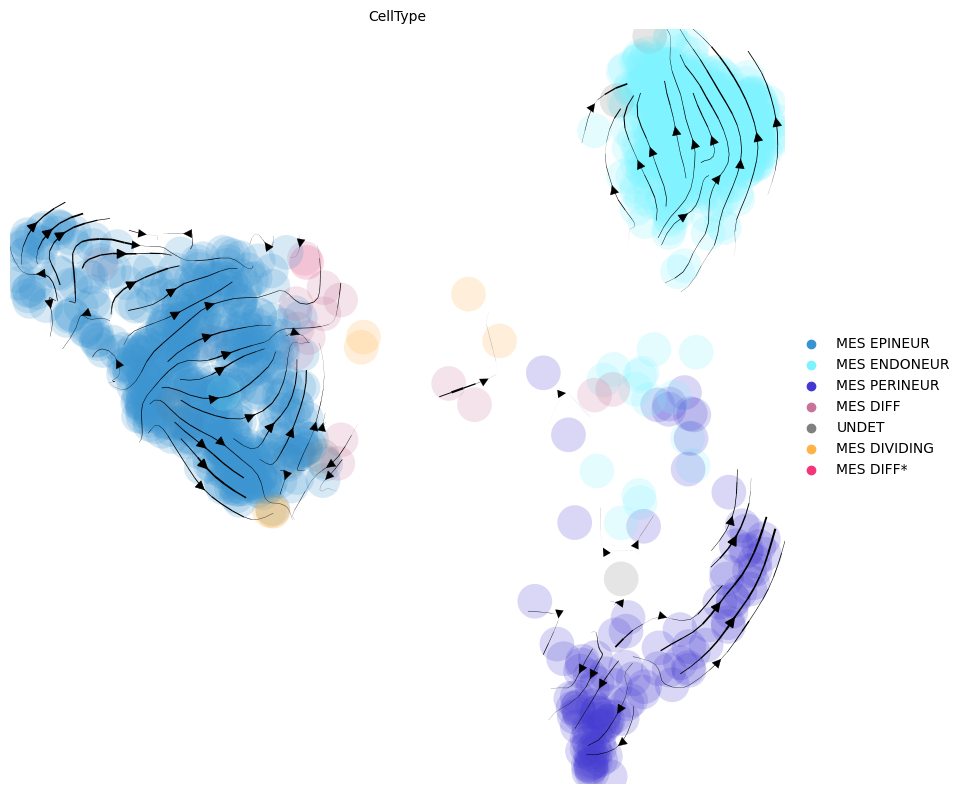

In [18]:
scv.pl.velocity_embedding_stream(intact_adata_filt_seurat, basis='umap', color=['CellType'], palette = palette_colori_aurora, 
                                 dpi=100, legend_loc='right_margin', linewidth = 1, figsize = [10, 10], size = 2500,alpha = 0.2,
                                 #save= '../OUTPUT/scVelo_UMAP_plot_Intact.svg', 
                                 arrow_size = 1.5)

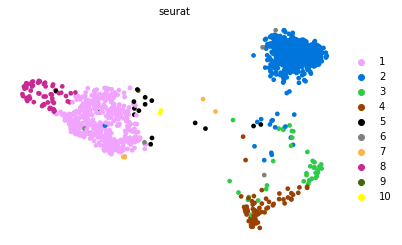

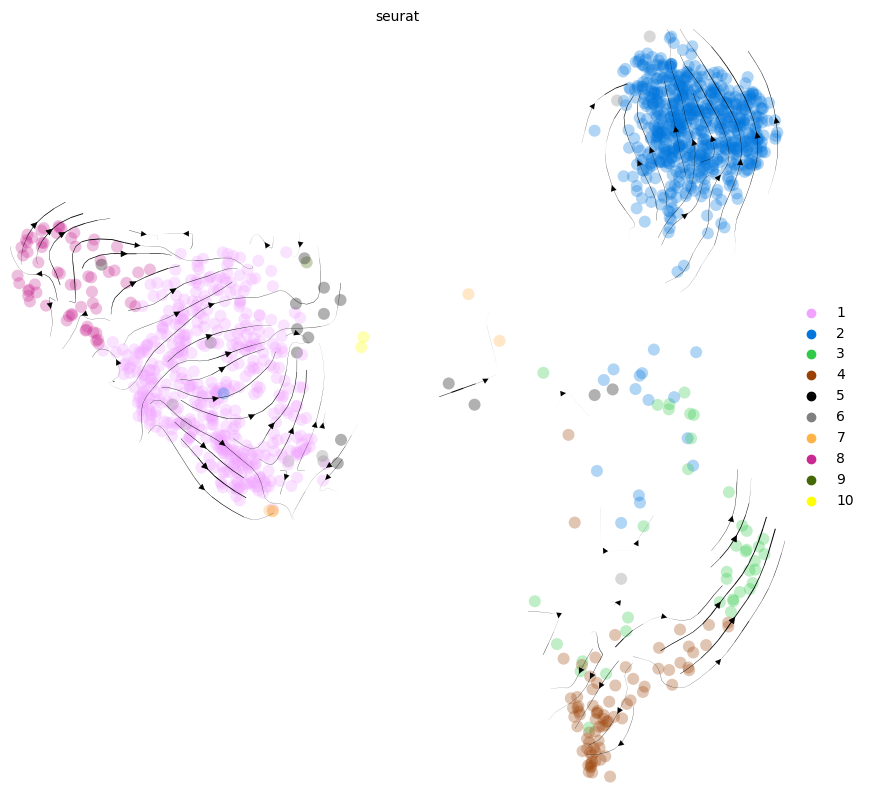

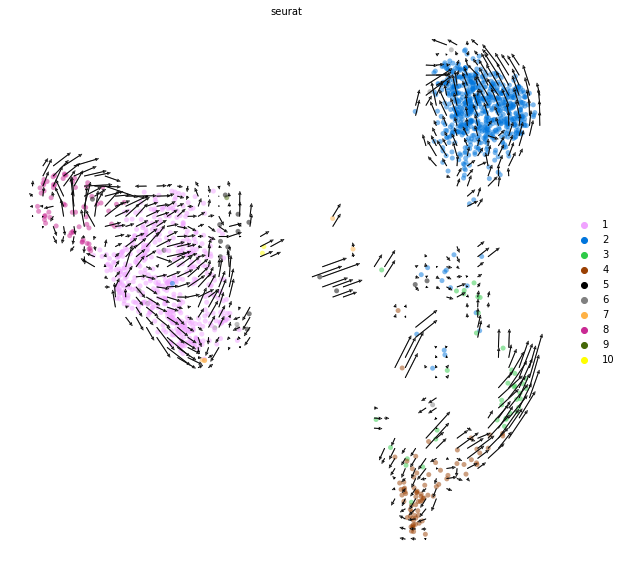

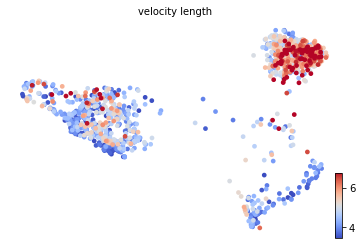

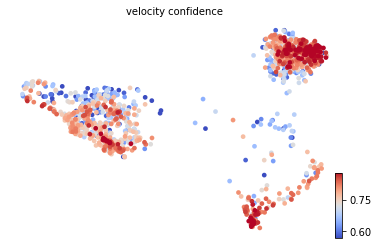

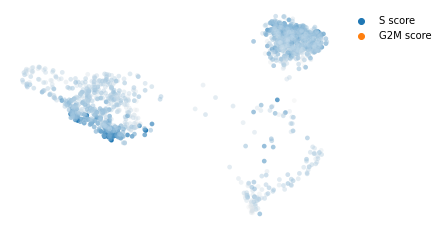

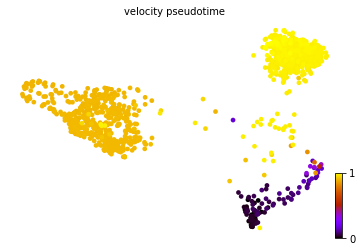

In [13]:
visualizeResults(intact_adata_filt_seurat,paletta_mia, filename = False)

### D7 Seurat

In [8]:
vettore_cluster = D7_adata_filt_seurat.obs['seurat']

thisdict = {
  "1": "MES_EPINEUR",
  "2": "MES_ENDONEUR",
  "3": "MES_PERINEUR",
  "4": "MES_PERINEUR",
  "5": "MES_DIFF",
  "6": "UNDET",
  "7": "MES_DIVIDING",
  "8": "MES_EPINEUR",
  "9": "MES_DIFF*",
  "10": "MES_DIVIDING"
}

vettore_cluster_new = vettore_cluster.replace(to_replace = thisdict)
#vettore_cluster_new
D7_adata_filt_seurat.obs['CellType'] = vettore_cluster_new

In [9]:
vettore_cluster_new

CellID
D7_TdTomato:AAAGAACGTCTAGTGTx     MES_EPINEUR
D7_TdTomato:AACACACAGTACTGTCx     MES_EPINEUR
D7_TdTomato:AAAGGATCAGTTTGGTx           UNDET
D7_TdTomato:AAAGTCCAGCCTCTTCx    MES_DIVIDING
D7_TdTomato:AACAACCCAGACTCTAx     MES_EPINEUR
                                     ...     
D7_TdTomato:TTTCGATCACGCGCTAx    MES_PERINEUR
D7_TdTomato:TTTCACATCATCAGTGx    MES_ENDONEUR
D7_TdTomato:TTTCATGAGTGCTAGGx    MES_PERINEUR
D7_TdTomato:TTTGGTTCAAGTCGTTx    MES_ENDONEUR
D7_TdTomato:TTTCACATCATTCGTTx     MES_EPINEUR
Name: seurat, Length: 2046, dtype: category
Categories (7, object): ['MES_EPINEUR', 'MES_ENDONEUR', 'MES_PERINEUR', 'MES_DIFF', 'UNDET', 'MES_DIVIDING', 'MES_DIFF*']

saving figure to file ../OUTPUT/scVelo_UMAP_plot_D7_senza_UNDET.svg


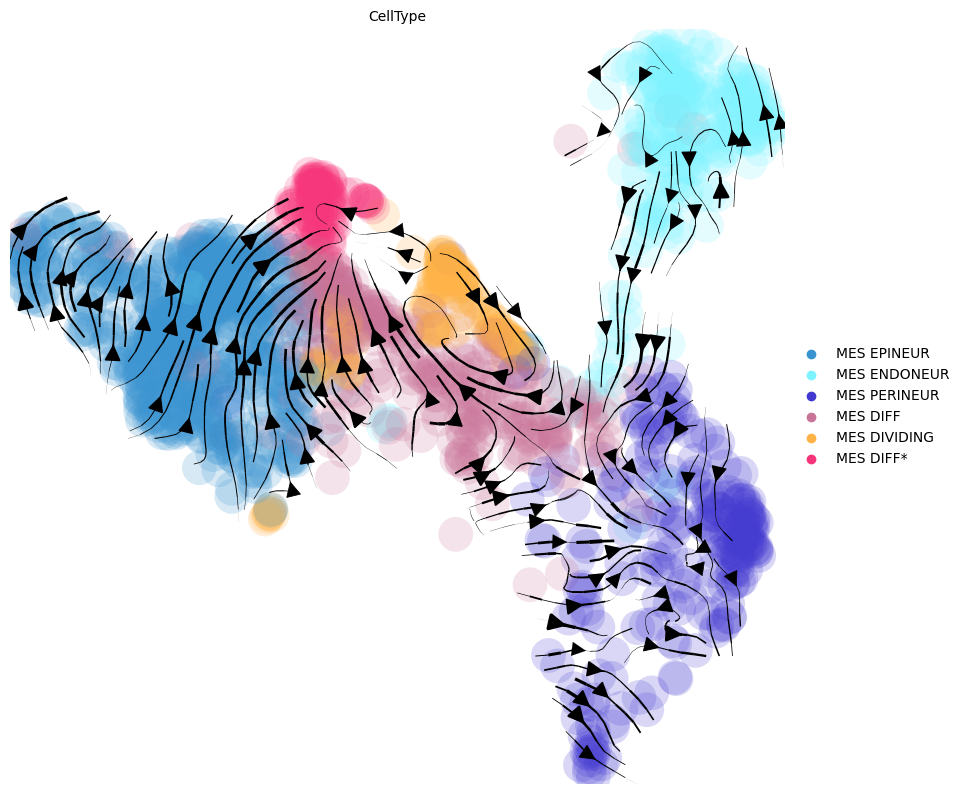

In [46]:
D7_adata_filt_seurat_with_out_UNDET =D7_adata_filt_seurat[D7_adata_filt_seurat.obs.CellType != "UNDET"]
scv.pl.velocity_embedding_stream(D7_adata_filt_seurat_with_out_UNDET, 
                                 basis='umap', color=['CellType'], palette = palette_colori_aurora_senza_UNDET, 
                                 dpi=100, legend_loc='right_margin',  figsize = [10, 10], size = 2500,
                                 save= '../OUTPUT/scVelo_UMAP_plot_D7_senza_UNDET.svg', 
                                 alpha = 0.2,
                                 linewidth = 1.5, 
                                 arrow_size = 2.5
                                )

In [27]:
D7_adata_filt_seurat_with_out_UNDET.obs

,Clusters,_X,_Y,seurat,cell_name,initial_size_spliced,initial_size_unspliced,initial_size,n_counts,velocity_self_transition,velocity_length,velocity_confidence,velocity_confidence_transition,S_score,G2M_score,phase,root_cells,end_points,velocity_pseudotime,CellType
CellID,,,,,,,,,,,,,,,,,,,,
D7_TdTomato:AAAGAACGTCTAGTGTx,2,36.036049,-5.591799,1,AAAGAACGTCTAGTGT,19636,2080,19636.0,15949.999023,0.153556,6.28,0.676843,0.110187,0.082107,-0.292711,S,0.0,0.105634,0.633525,MES_EPINEUR
D7_TdTomato:AACACACAGTACTGTCx,2,37.146172,8.560363,8,AACACACAGTACTGTC,20278,1731,20278.0,15949.998047,0.168730,8.72,0.860600,0.017227,-0.088974,-0.303693,G1,0.0,0.306337,0.439122,MES_EPINEUR
D7_TdTomato:AAAGTCCAGCCTCTTCx,0,-30.216637,7.405733,7,AAAGTCCAGCCTCTTC,32241,5057,32241.0,15950.000977,0.280855,5.42,0.887471,0.040650,0.626569,0.885923,G2M,0.0,0.000224,0.352738,MES_DIVIDING
D7_TdTomato:AACAACCCAGACTCTAx,1,-12.220151,-4.057003,1,AACAACCCAGACTCTA,16671,1704,16671.0,15949.999023,0.118069,5.98,0.703437,0.252801,0.060903,-0.267680,S,0.0,0.070464,0.642298,MES_EPINEUR
D7_TdTomato:AACCATGCACAACGTTx,1,-11.046401,-2.355440,5,AACCATGCACAACGTT,20306,2062,20306.0,15949.999023,0.172594,6.28,0.825046,0.071353,0.020061,-0.229814,S,0.0,1.000000,0.936920,MES_DIFF
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
D7_TdTomato:TTTCGATCACGCGCTAx,0,-13.390722,7.128710,4,TTTCGATCACGCGCTA,12013,1455,12013.0,15950.000000,0.177131,5.02,0.745847,0.089663,-0.045287,-0.287679,G1,0.0,0.122134,0.386821,MES_PERINEUR
D7_TdTomato:TTTCACATCATCAGTGx,2,25.310341,-11.203266,2,TTTCACATCATCAGTG,18462,1679,18462.0,15950.000977,0.152201,6.15,0.780012,0.113783,0.062207,-0.269364,S,0.0,0.179147,0.366530,MES_ENDONEUR
D7_TdTomato:TTTCATGAGTGCTAGGx,5,-26.297775,-29.819731,3,TTTCATGAGTGCTAGG,13461,1699,13461.0,15950.000977,0.022798,6.03,0.862866,0.158812,-0.116578,-0.252988,G1,0.0,0.198414,0.448159,MES_PERINEUR


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file ../OUTPUT/scVelo_UMAP_plot_D7.svg


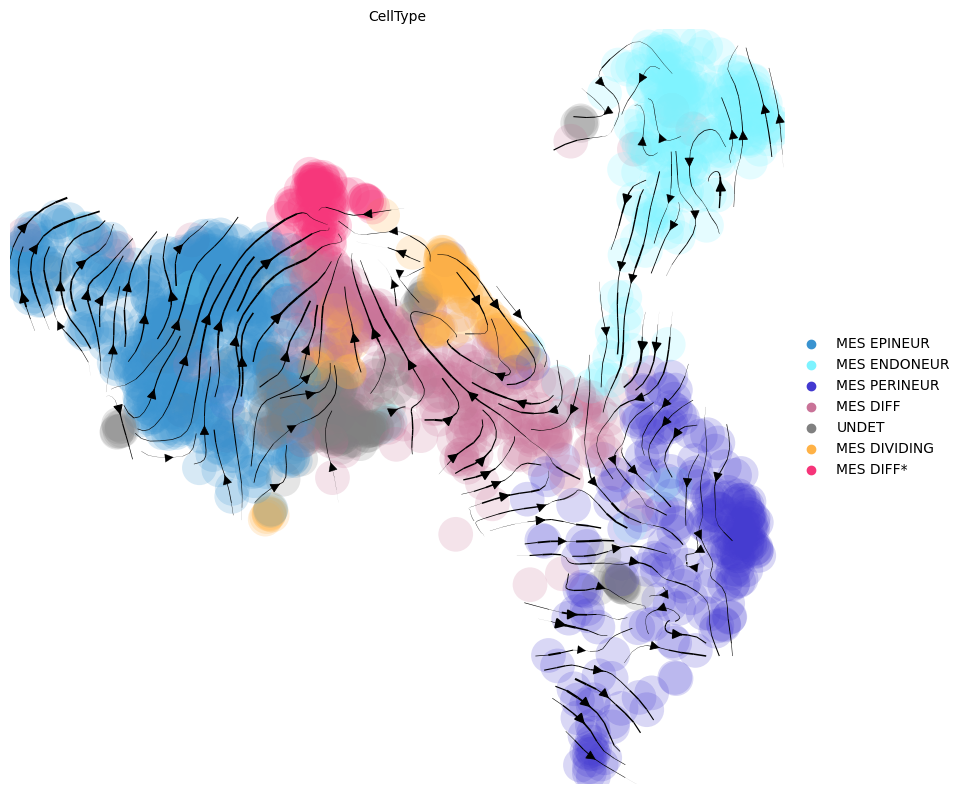

In [34]:
scv.pl.velocity_embedding_stream(D7_adata_filt_seurat, basis='umap', color=['CellType'], palette = palette_colori_aurora, 
                                 dpi=100, legend_loc='right_margin', linewidth = 1, figsize = [10, 10],size = 2500,alpha = 0.2,
                                 arrow_size = 1.5,  save= '../OUTPUT/scVelo_UMAP_plot_D7.svg')

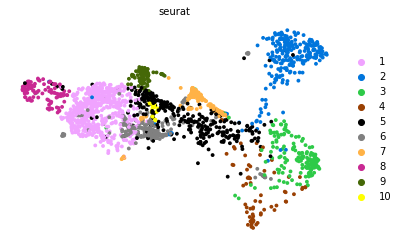

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


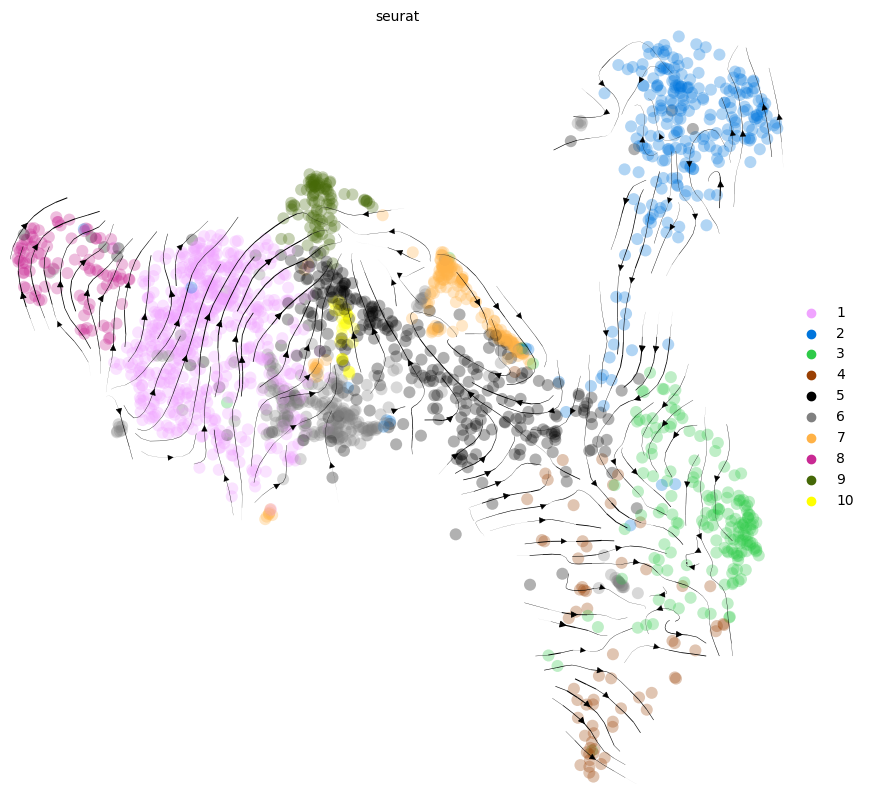

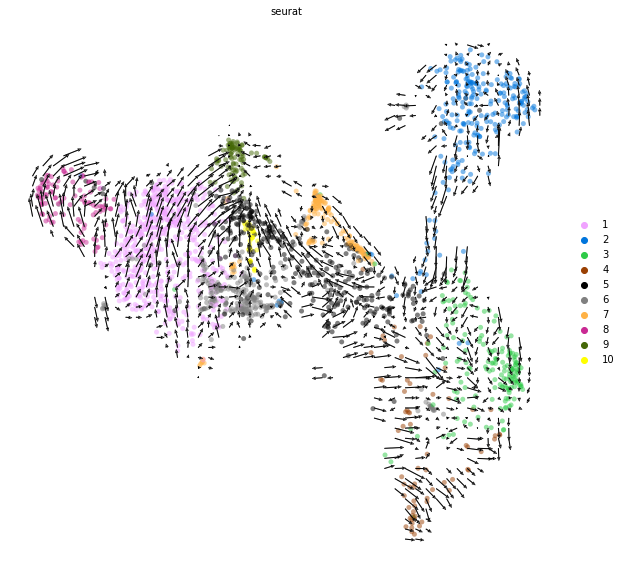

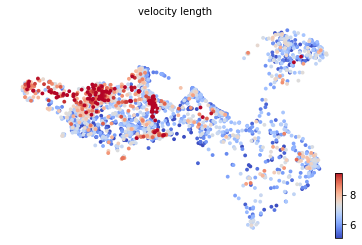

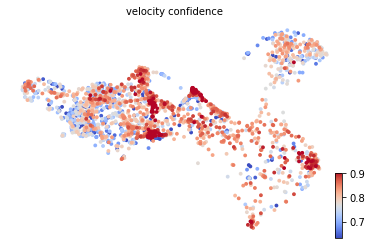

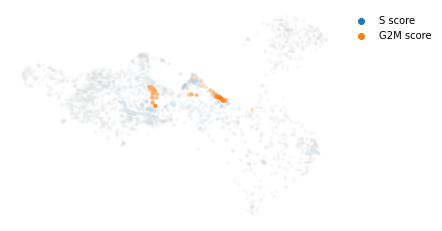

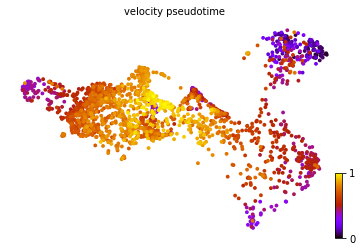

In [14]:
visualizeResults(D7_adata_filt_seurat,paletta_mia, filename = False)

### D21

In [10]:
vettore_cluster = D21_adata_filt_seurat.obs['seurat']
vettore_cluster_new = vettore_cluster.replace(to_replace = thisdict)
#vettore_cluster_new
D21_adata_filt_seurat.obs['CellType'] = vettore_cluster_new

In [11]:
vettore_cluster_new

CellID
D21_TdTomato:AAATGGAAGACCAACGx    MES_PERINEUR
D21_TdTomato:AAATGGAAGAAATTGCx    MES_PERINEUR
D21_TdTomato:AAAGTGAGTGTGTTTGx    MES_PERINEUR
D21_TdTomato:AAAGTCCAGTCGCTATx        MES_DIFF
D21_TdTomato:AAACGCTCAAATAGCAx    MES_PERINEUR
                                      ...     
D21_TdTomato:TTTGGTTAGAAGTCATx     MES_EPINEUR
D21_TdTomato:TTTGGTTCATAGAGGCx    MES_PERINEUR
D21_TdTomato:TTTGTTGGTTCTCTCGx    MES_PERINEUR
D21_TdTomato:TTTGTTGTCGCCGAACx    MES_PERINEUR
D21_TdTomato:TTTGGAGTCGTTCCTGx    MES_ENDONEUR
Name: seurat, Length: 4138, dtype: category
Categories (7, object): ['MES_EPINEUR', 'MES_ENDONEUR', 'MES_PERINEUR', 'MES_DIFF', 'UNDET', 'MES_DIVIDING', 'MES_DIFF*']

saving figure to file ../OUTPUT/scVelo_UMAP_plot_D21_senza_UNDET.svg


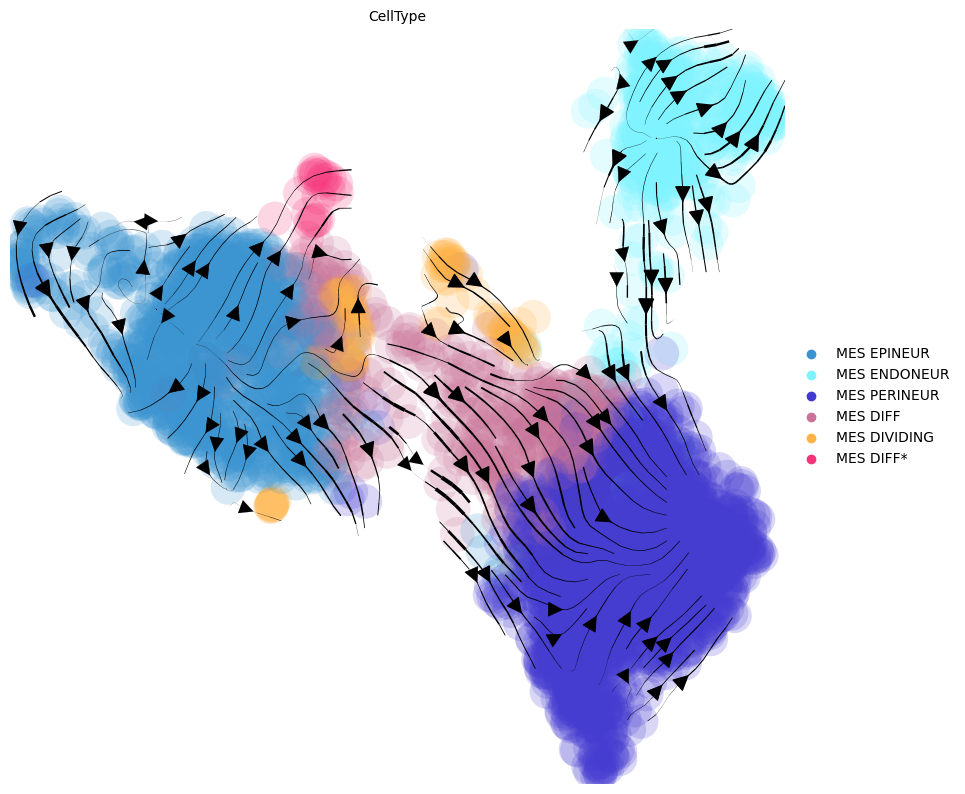

In [45]:
D21_adata_filt_seurat_with_out_UNDET =D21_adata_filt_seurat[D21_adata_filt_seurat.obs.CellType != "UNDET"]
scv.pl.velocity_embedding_stream(D21_adata_filt_seurat_with_out_UNDET, 
                                 basis='umap', color=['CellType'], palette = palette_colori_aurora_senza_UNDET, 
                                 dpi=100, legend_loc='right_margin', 
                                  alpha = 0.2,
                                 linewidth = 1.5, 
                                 arrow_size = 2.5,
                                 figsize = [10, 10], size = 2500,
                                 
                                 save= '../OUTPUT/scVelo_UMAP_plot_D21_senza_UNDET.svg'
                                )

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file ../OUTPUT/scVelo_UMAP_plot_D21.svg


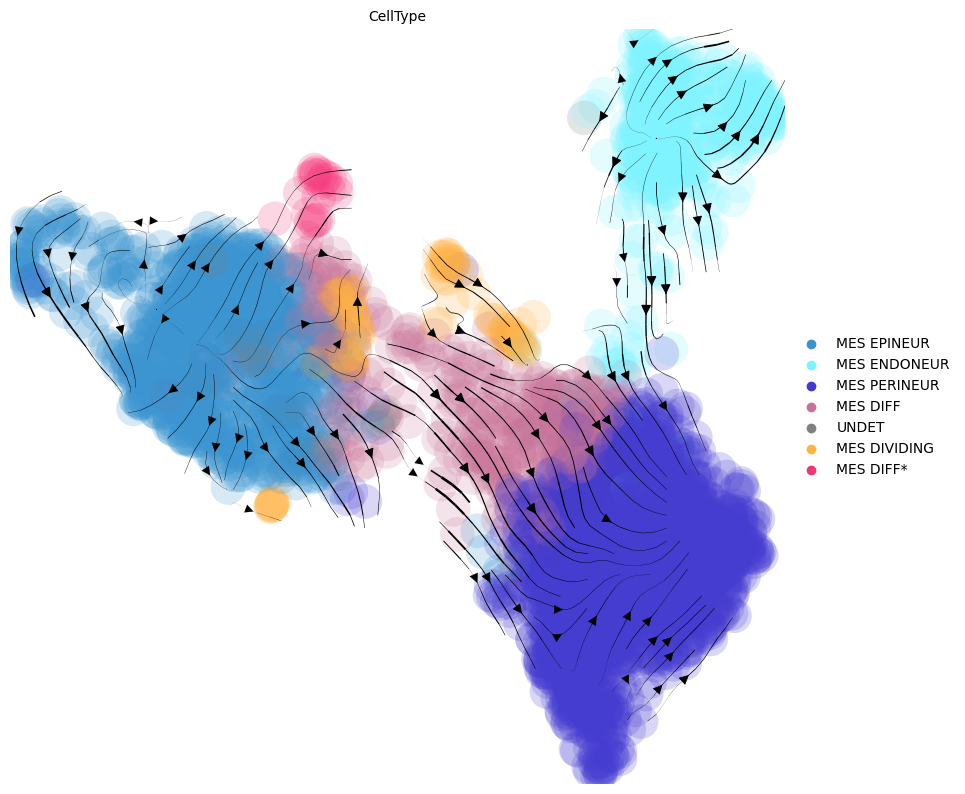

In [38]:
scv.pl.velocity_embedding_stream(D21_adata_filt_seurat, basis='umap', color=['CellType'], palette = palette_colori_aurora, 
                                 dpi=100, legend_loc='right_margin', linewidth = 1, figsize = [10, 10], size = 2500,alpha = 0.2,
                                 arrow_size = 1.5, save= '../OUTPUT/scVelo_UMAP_plot_D21.svg',)

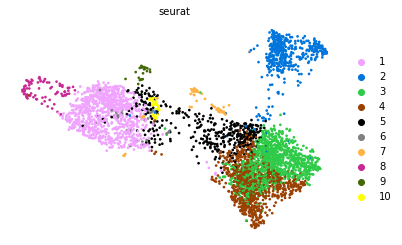

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


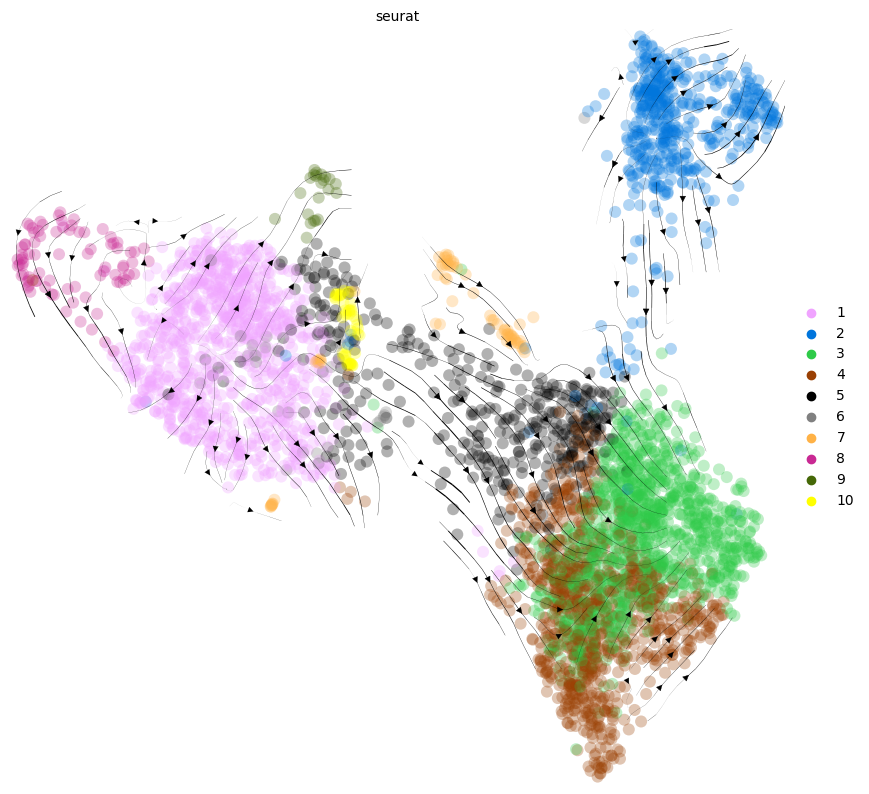

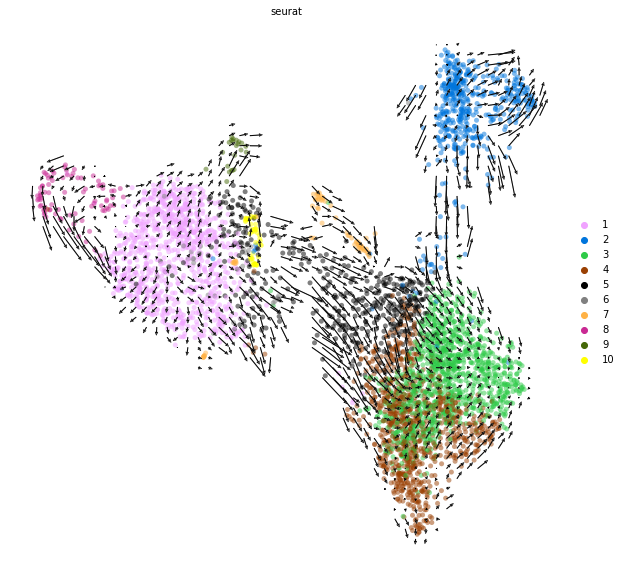

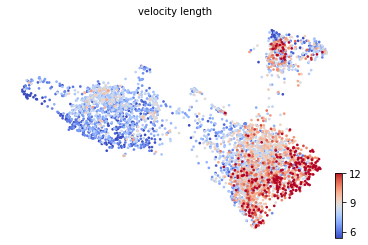

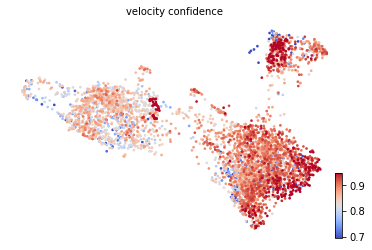

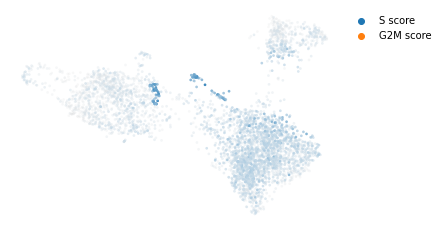

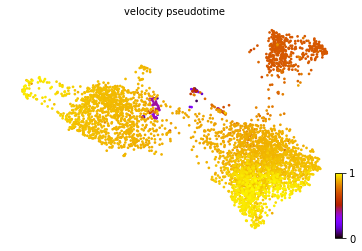

In [15]:
visualizeResults(D21_adata_filt_seurat,paletta_mia, filename = False)

#### Intact

In [20]:
variables = 'velocity_length', 'velocity_confidence'
df = intact_adata_filt_seurat.obs.groupby('seurat')[variables].mean().T
df.style.background_gradient(cmap='coolwarm', axis=1)

seurat,1,2,3,4,5,6,7,8,9,10
velocity_length,4.331820,5.236335,4.349487,4.184026,4.277500,4.522500,3.886000,4.620323,4.940000,4.270000
velocity_confidence,0.733317,0.739602,0.737119,0.818124,0.670720,0.692391,0.665130,0.709081,0.673225,0.517370


#### D7

In [21]:
variables = 'velocity_length', 'velocity_confidence'
df = D7_adata_filt_seurat.obs.groupby('seurat')[variables].mean().T
df.style.background_gradient(cmap='coolwarm', axis=1)

seurat,1,2,3,4,5,6,7,8,9,10
velocity_length,7.224809,6.351373,6.429368,6.348657,6.566558,6.849248,6.257955,8.075500,6.640213,9.989333
velocity_confidence,0.747881,0.767976,0.814644,0.797251,0.802439,0.795102,0.805642,0.770476,0.805757,0.943270


#### D21

In [22]:
variables = 'velocity_length', 'velocity_confidence'
df = D21_adata_filt_seurat.obs.groupby('seurat')[variables].mean().T
df.style.background_gradient(cmap='coolwarm', axis=1)

seurat,1,2,3,4,5,6,7,8,9,10
velocity_length,6.914439,8.015010,8.994617,9.304934,7.472455,7.022222,7.903043,6.166747,6.801363,8.212600
velocity_confidence,0.830808,0.864295,0.859194,0.845986,0.862297,0.748836,0.869867,0.807032,0.867230,0.960588


### Intact

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:00) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


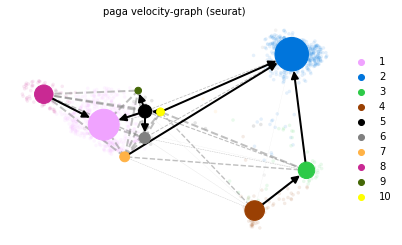

In [23]:
Paga_function(intact_adata_filt_seurat)

### D7

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:00) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


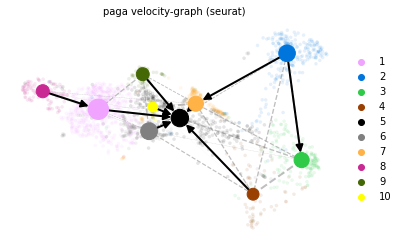

In [24]:
Paga_function(D7_adata_filt_seurat)

### D21

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:00) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


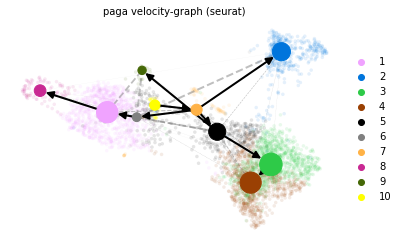

In [25]:
Paga_function(D21_adata_filt_seurat)

In [30]:
lista_D21 = Identify_important_genes(D21_adata_filt_seurat_with_out_UNDET)

ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)
Results cluster MES_EPINEUR
saving figure to file /beegfs/scratch/ric.cosr/ric.bonanomi/TdTomato_scAtlas/SCVELO_IMAGES/D21_from0_to20_MES_EPINEUR.pdf
Results cluster MES_ENDONEUR
saving figure to file /beegfs/scratch/ric.cosr/ric.bonanomi/TdTomato_scAtlas/SCVELO_IMAGES/D21_from0_to20_MES_ENDONEUR.pdf
Results cluster MES_PERINEUR
saving figure to file /beegfs/scratch/ric.cosr/ric.bonanomi/TdTomato_scAtlas/SCVELO_IMAGES/D21_from0_to20_MES_PERINEUR.pdf
Results cluster MES_DIFF
saving figure to file /beegfs/scratch/ric.cosr/ric.bonanomi/TdTomato_scAtlas/SCVELO_IMAGES/D21_from0_to20_MES_DIFF.pdf
Results cluster MES_DIVIDING
saving figure to file /beegfs/scratch/ric.cosr/ric.bonanomi/TdTomato_scAtlas/SCVELO_IMAGES/D21_from0_to20_MES_DIVIDING.pdf
Results cluster MES_DIFF*
saving figure to file /beegfs/scratc

In [19]:
lista_D21

,MES_EPINEUR,MES_ENDONEUR,MES_PERINEUR,MES_DIFF,MES_DIVIDING,MES_DIFF*
0,Dcn,Col8a1,Gm4804,Meg3,Sbno2,Thbs4
1,Col12a1,Fat3,Dock6,Sned1,Sox6,Rgcc
2,Rian,Unc13c,Clstn2,Knl1,Nipal1,Creb5
3,Ly6c1,Dnm3,Ntrk3,Tnxb,Ncam1,Car8
4,1200007C13Rik,Eps8,Nr3c2,Adgrd1,Negr1,Col11a1
...,...,...,...,...,...,...
95,Timp1,Sema5a,Abca8a,Neil3,Nfkbia,Itga11
96,Mmp3,Gnas,Lbp,Cxcl14,Cyp1b1,Hmcn2
97,Itgb5,Il4ra,Ccl8,Fez1,Cacna1h,Filip1
98,Pim1,Nr1h4,Tjp2,Cpxm2,Lockd,Fmod


In [55]:
lista_D7.to_csv('/beegfs/scratch/ric.cosr/ric.bonanomi/R_DARA_BonanomiD_1807_10x_scrna_nerve_merged/Lista_scVelo_important_genes_D7.csv')
lista_D21.to_csv('/beegfs/scratch/ric.cosr/ric.bonanomi/R_DARA_BonanomiD_1807_10x_scrna_nerve_merged/Lista_scVelo_important_genes_D21.csv')

,MES_EPINEUR,MES_ENDONEUR,MES_PERINEUR,MES_DIFF,MES_DIVIDING,MES_DIFF*
0,Dcn,Col8a1,Gm4804,Meg3,Sbno2,Thbs4
1,Col12a1,Fat3,Dock6,Sned1,Sox6,Rgcc
2,Rian,Unc13c,Clstn2,Knl1,Nipal1,Creb5
3,Ly6c1,Dnm3,Ntrk3,Tnxb,Ncam1,Car8
4,1200007C13Rik,Eps8,Nr3c2,Adgrd1,Negr1,Col11a1
...,...,...,...,...,...,...
95,Timp1,Sema5a,Abca8a,Neil3,Nfkbia,Itga11
96,Mmp3,Gnas,Lbp,Cxcl14,Cyp1b1,Hmcn2
97,Itgb5,Il4ra,Ccl8,Fez1,Cacna1h,Filip1
98,Pim1,Nr1h4,Tjp2,Cpxm2,Lockd,Fmod


### dati concatenati e integrati

In [40]:
adata_concat = intact_adata_filt_seurat.concatenate(D7_adata_filt_seurat,D21_adata_filt_seurat)

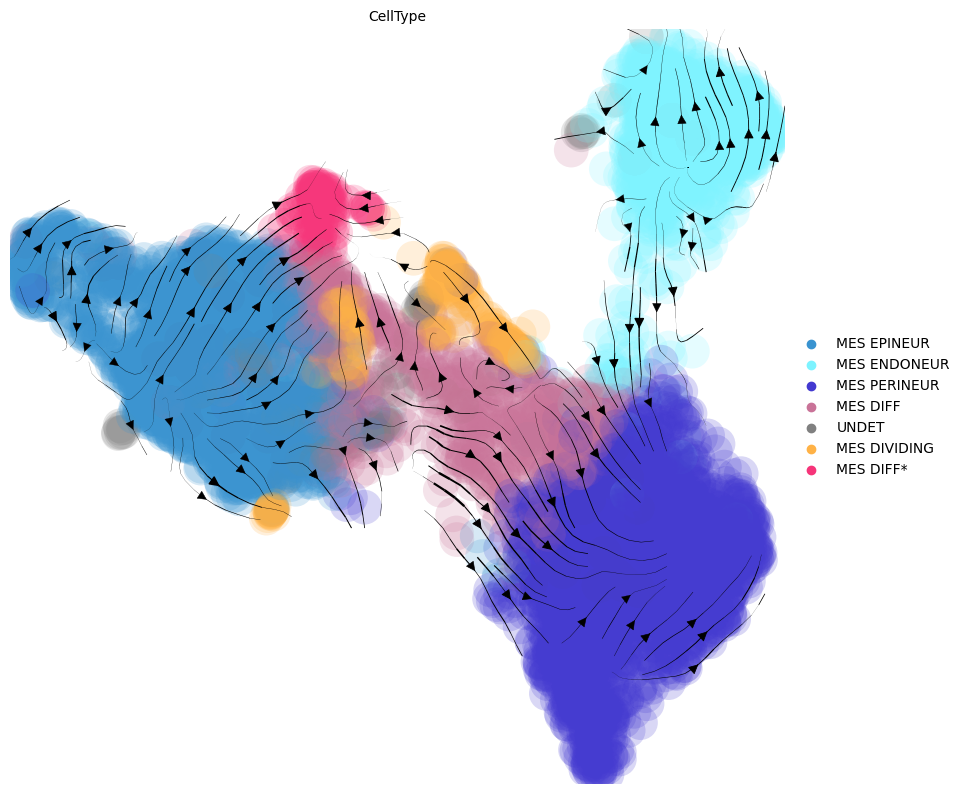

In [41]:
scv.pl.velocity_embedding_stream(adata_concat, basis='umap', color=['CellType'], palette = palette_colori_aurora, 
                                 dpi=100, legend_loc='right_margin', linewidth = 1, figsize = [10, 10], size = 2500,alpha = 0.2,
                                 arrow_size = 1.5, 
                                 #save= '../OUTPUT/scVelo_UMAP_plot_D21.svg',
                                )

ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)
Results cluster 1


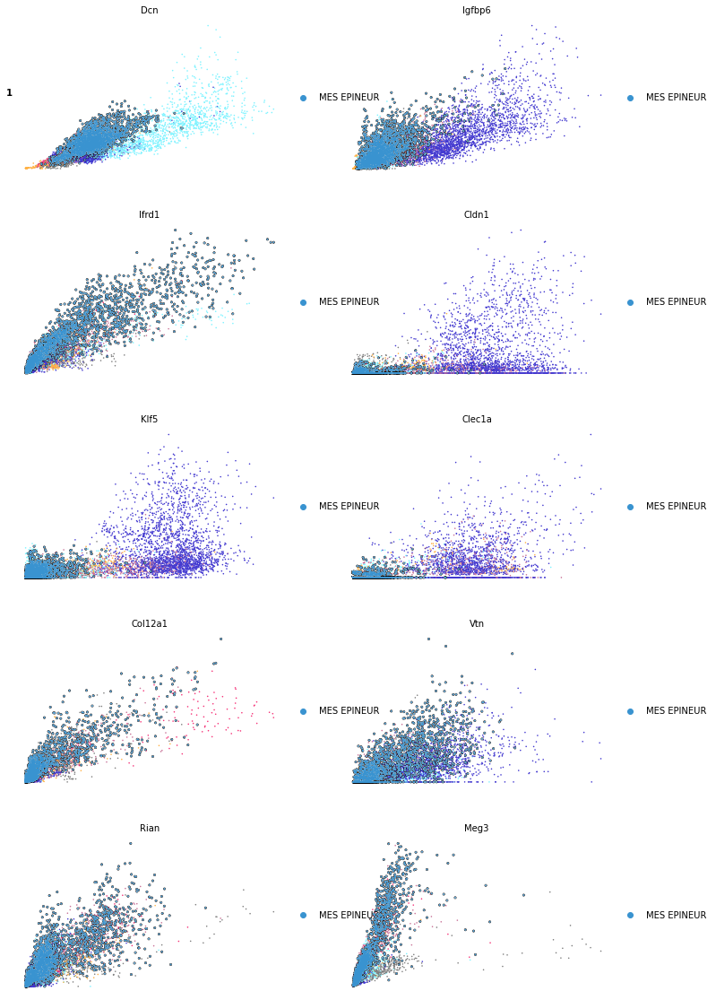

Results cluster 2


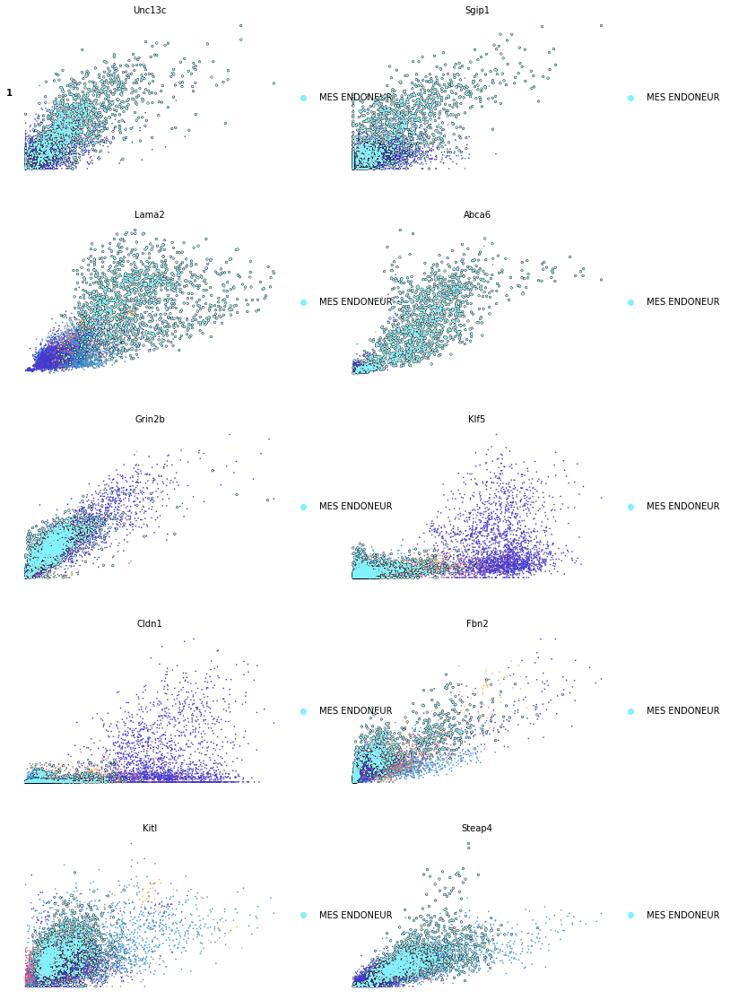

Results cluster 3


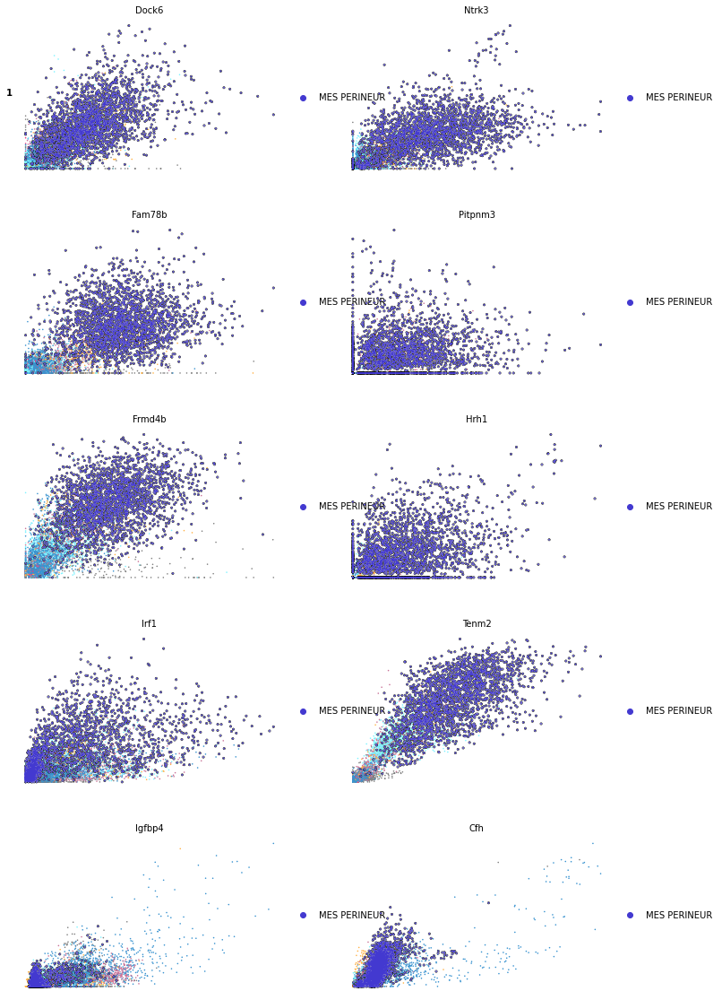

Results cluster 4


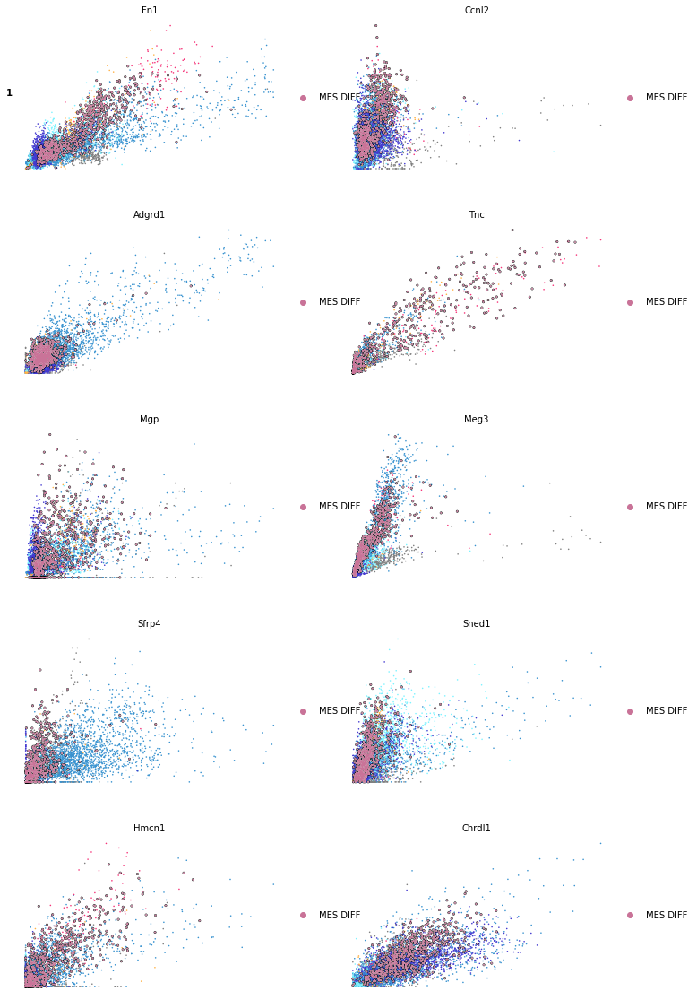

Results cluster 5


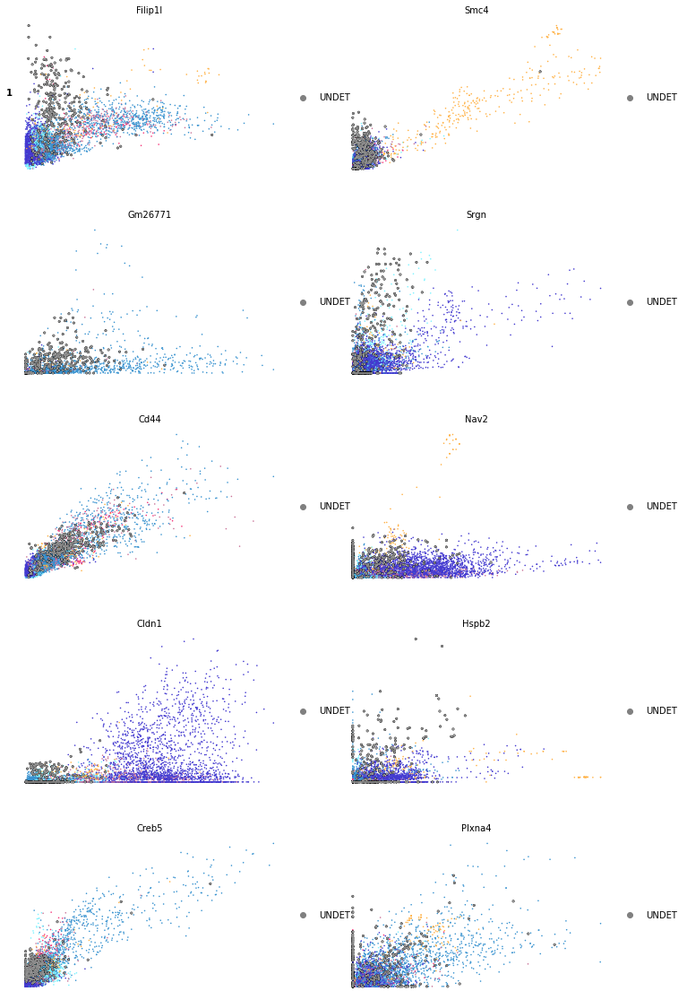

Results cluster 6


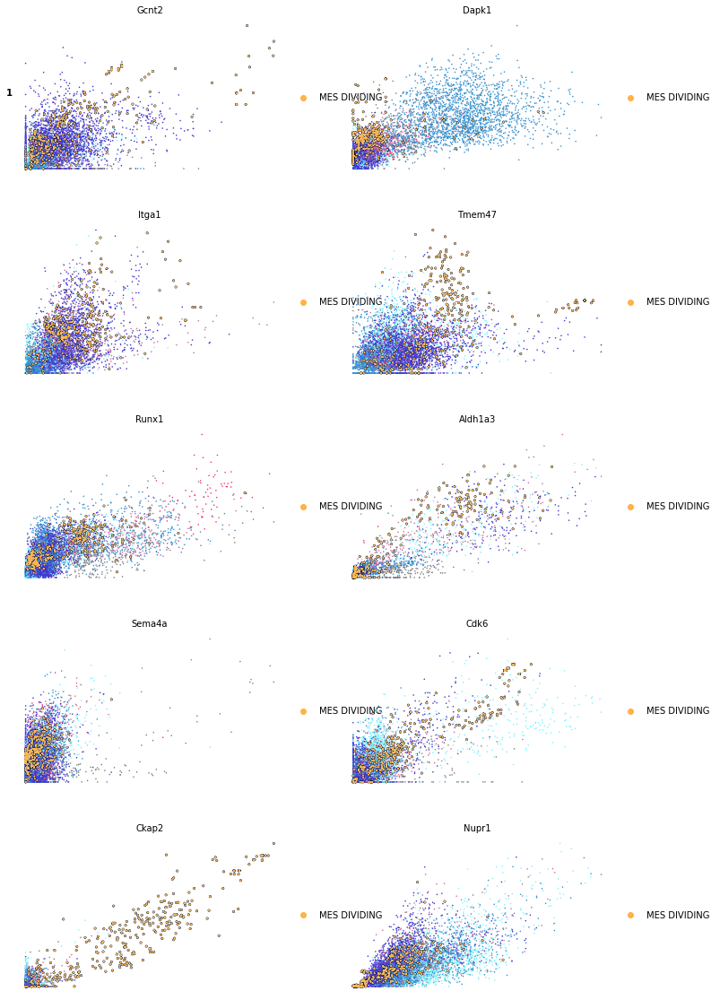

Results cluster 7


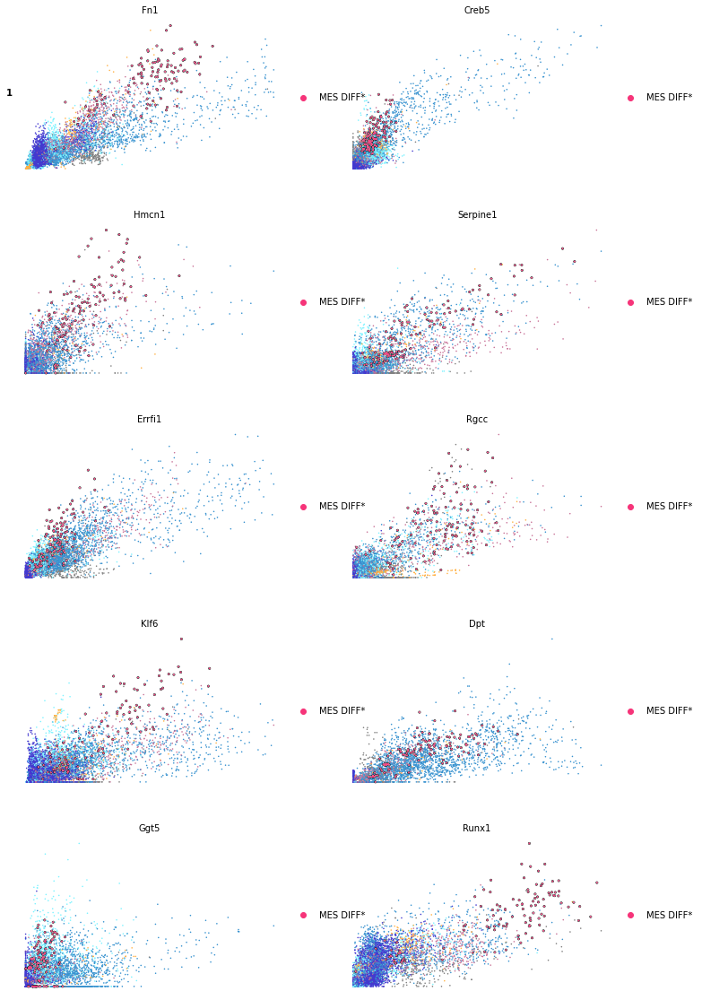

SyntaxError: 'return' outside function (837571215.py, line 11)

In [62]:
    #CellType
    #def Identify_important_genes(adata_filt_seurat):
    adata_filt_seurat = adata_concat
    scv.tl.rank_velocity_genes(adata_filt_seurat, groupby='CellType', min_corr=.3)
    df = scv.DataFrame(adata_filt_seurat.uns['rank_velocity_genes']['names'])
    for i in range(df.shape[1]):
        print("Results cluster "+ str(i+1))
        i = str(df.columns.values.tolist()[i])
        kwargs = dict(frameon=False, size=10, linewidth=1.5,add_outline=str(i))
        scv.pl.scatter(adata_filt_seurat, df[str(i)][:10], ylabel='1',color='CellType', **kwargs, ncols=2, legend_loc = "right margin")
    return(df)
    #tmp = Identify_important_genes(adata_concat)


In [59]:
df.columns.values.tolist()[i]

['MES_EPINEUR',
 'MES_ENDONEUR',
 'MES_PERINEUR',
 'MES_DIFF',
 'UNDET',
 'MES_DIVIDING',
 'MES_DIFF*']